## Домашнее задание №3. Елизаров Константин, MADE-DS-31

In [26]:
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F

from glob import glob
from PIL import Image
from torchvision import transforms, utils
from IPython.display import display
from tqdm import tqdm

## Часть 1. pix2pix

В этом задании мы будем реализовывать перенос стиля на спаренных данных (paired data). Из стандартных датасетов я выбрал самый маленький -- давайте реализуем перенос стиля из масок сегментации в “настоящие фотографии” для конкретного случая фасадов домов.

В первой части подразумевается реализация pix2pix архитектуры, т.е. генератора и дискриминатора, которые получают на вход условие в виде изображения исходного стиля.

In [27]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [28]:
PATH = 'drive/MyDrive/Advanced RL and DL hw3/'

In [29]:
BATCH_SIZE = 8
LR = 1e-4
BETA = 0.5
N_STEPS = 200
LAMBDA = 100

In [ ]:
class Dataset(torch.utils.data.Dataset):
    
    def __init__(self, folder=PATH + 'facades/train'):
        self.folder = folder
        self.files = glob(self.folder + '/*.jpg');
        self.transforms = transforms.Compose([
            transforms.ToTensor(),
        ])
        
    def __getitem__(self, idx):
        imgs = Image.open(self.files[idx]).convert("RGB")
        first_img, second_img = imgs.crop((256, 0, 512, 256)), imgs.crop((0, 0, 256, 256))
        return self.transforms(first_img), self.transforms(second_img)    
        
    def __len__(self):
        return len(self.files)


train_dataset = Dataset(folder=PATH + 'facades/train')
train_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)

test_dataset = Dataset(folder=PATH + 'facades/test')
test_dataloader = torch.utils.data.DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)

In [ ]:
class UnetSkipConnectionBlock(nn.Module):
    """Unet submodule with skip connection."""

    def __init__(self, outer_nc, inner_nc, input_nc=None, submodule=None, outermost=False, 
                 innermost=False, use_bias=False, use_dropout=False):
        """Constructor of a Unet submodule.
        Parameters:
            outer_nc, int - the number of filters in the outer conv layer
            inner_nc, int - the number of filters in the inner conv layer
            input_nc, int - the number of channels in input images
            submodule, UnetSkipConnectionBlock - previously defined submodules
            outermost, bool - if this module is the outermost module
            innermost, bool - if this module is the innermost module
            use_bias, bool - use bias or not
            use_dropout, bool - use dropout or not
        """
        super().__init__()
        self.outermost = outermost
            
        if input_nc is None:
            input_nc = outer_nc
            
        downconv = nn.Conv2d(input_nc, inner_nc, kernel_size=4, stride=2, padding=1, bias=use_bias)
        downrelu = nn.LeakyReLU(0.2, True)
        downnorm = nn.InstanceNorm2d(inner_nc)
        uprelu = nn.ReLU(True)
        upnorm = nn.InstanceNorm2d(outer_nc)

        if outermost:
            upconv = nn.ConvTranspose2d(inner_nc * 2, outer_nc, kernel_size=4, stride=2, padding=1)
            model = [downconv] + [submodule] + [uprelu, upconv, nn.Tanh()]
        elif innermost:
            upconv = nn.ConvTranspose2d(inner_nc, outer_nc, kernel_size=4, stride=2, padding=1, bias=use_bias)
            model = [downrelu, downconv] + [uprelu, upconv, upnorm]
        else:
            upconv = nn.ConvTranspose2d(inner_nc * 2, outer_nc, kernel_size=4, stride=2, padding=1, bias=use_bias)
            if use_dropout:
                model = [downrelu, downconv, downnorm] + [submodule] + [uprelu, upconv, upnorm] + [nn.Dropout(0.5)]
            else:
                model = [downrelu, downconv, downnorm] + [submodule] + [uprelu, upconv, upnorm]
                

        self.model = nn.Sequential(*model)

    def forward(self, x):
        if self.outermost:
            return self.model(x)
        else:
            return torch.cat([x, self.model(x)], 1)


class UnetGenerator(nn.Module):
    """Unet-based generator."""

    def __init__(self, input_nc, output_nc, n_downs, n_filt=64, use_bias=False, use_dropout=False):
        """Constructor of a Unet generator.
        Parameters:
            input_nc, int - the number of channels in input images
            output_nc, int - the number of channels in output images
            n_downs, int - the number of downsamplings
            n_filt, int - the number of filters
            use_bias, bool - use bias or not
            use_dropout, bool - use dropout or not
        """
        super().__init__()
        # add the innermost layer
        unet_block = UnetSkipConnectionBlock(n_filt * 8, n_filt * 8, input_nc=None, 
                                             submodule=None, use_bias=use_bias, innermost=True)
        # add intermediate layers recursively
        for i in range(n_downs - 5):
            unet_block = UnetSkipConnectionBlock(n_filt * 8, n_filt * 8, input_nc=None, 
                                                 submodule=unet_block, use_bias=use_bias, 
                                                 use_dropout=use_dropout)
            
        # reduce the number of filters
        unet_block = UnetSkipConnectionBlock(n_filt * 4, n_filt * 8, input_nc=None, 
                                             submodule=unet_block, use_bias=use_bias)
        unet_block = UnetSkipConnectionBlock(n_filt * 2, n_filt * 4, input_nc=None, 
                                             submodule=unet_block, use_bias=use_bias)
        unet_block = UnetSkipConnectionBlock(n_filt, n_filt * 2, input_nc=None, 
                                             submodule=unet_block, use_bias=use_bias)
        
        # add the outermost layer
        self.model = UnetSkipConnectionBlock(output_nc, n_filt, input_nc=input_nc, 
                                             submodule=unet_block, outermost=True, use_bias=use_bias)

    def forward(self, x):
        """Forward pass."""
        return self.model(x)


In [ ]:
class Discriminator(nn.Module):
    """Discriminator class."""

    def __init__(self, input_dim, n_filt=64, n_layers=3, use_bias=False):
        """Constructor of a discriminator.
        Parameters:
            input_dim, int - the number of channels in input images
            n_filt, int - the number of filters
            n_layers, int - the number of conv layers in the discriminator
            use_bias, bool - use bias or not
        """
        super().__init__()

        kernel_size = 4
        pad = 1
        sequence = [
            nn.Conv2d(input_dim, n_filt, kernel_size=kernel_size, stride=2, padding=pad), 
            nn.LeakyReLU(0.2, True)
        ]
        nf_mult = 1
        nf_mult_prev = 1
        for n in range(1, n_layers):  # increase the number of filters
            nf_mult_prev = nf_mult
            nf_mult = min(2 ** n, 8)
            sequence += [
                nn.Conv2d(n_filt * nf_mult_prev, n_filt * nf_mult, 
                          kernel_size=kernel_size, stride=2, padding=pad, bias=use_bias),
                nn.InstanceNorm2d(n_filt * nf_mult),
                nn.LeakyReLU(0.2, True)
            ]

        nf_mult_prev = nf_mult
        nf_mult = min(2 ** n_layers, 8)
        sequence += [
            nn.Conv2d(n_filt * nf_mult_prev, n_filt * nf_mult, 
                      kernel_size=kernel_size, stride=1, padding=pad, bias=use_bias),
            nn.InstanceNorm2d(n_filt * nf_mult),
            nn.LeakyReLU(0.2, True)
        ]

        sequence += [nn.Conv2d(n_filt * nf_mult, 1, kernel_size=kernel_size, stride=1, padding=pad)]
        self.model = nn.Sequential(*sequence)

    def forward(self, x):
        """Standard forward."""
        return self.model(x)

In [ ]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
device

device(type='cuda')

In [ ]:
gen = UnetGenerator(input_nc=3, output_nc=3, n_downs=8, n_filt=64, use_dropout=False).to(device)
discr = Discriminator(input_dim=3 + 3, n_filt=64, use_bias=False).to(device)

In [ ]:
gen_opt = torch.optim.Adam(gen.parameters(), lr=LR, betas=(BETA, 0.999))
discr_opt = torch.optim.Adam(discr.parameters(), lr=LR, betas=(BETA, 0.999))

Epoch: 1/200, gen_loss: 21.41855239868164, discr_loss: 0.12108621001243591
Epoch: 2/200, gen_loss: 19.82749366760254, discr_loss: 0.07043840736150742
Epoch: 3/200, gen_loss: 18.921810150146484, discr_loss: 0.08507131040096283
Epoch: 4/200, gen_loss: 20.388620376586914, discr_loss: 0.03402651846408844
Epoch: 5/200, gen_loss: 17.58112907409668, discr_loss: 0.07663320004940033
Epoch: 6/200, gen_loss: 16.884803771972656, discr_loss: 0.030948173254728317
Epoch: 7/200, gen_loss: 18.09115219116211, discr_loss: 0.15454792976379395
Epoch: 8/200, gen_loss: 20.517099380493164, discr_loss: 0.028507696464657784
Epoch: 9/200, gen_loss: 17.33354377746582, discr_loss: 0.02541513741016388
Epoch: 10/200, gen_loss: 18.592206954956055, discr_loss: 0.0545361153781414
Epoch: 11/200, gen_loss: 16.92207908630371, discr_loss: 0.034940436482429504
Epoch: 12/200, gen_loss: 15.11113452911377, discr_loss: 0.007240280508995056
Epoch: 13/200, gen_loss: 15.690524101257324, discr_loss: 0.015920665115118027
Epoch: 14/2

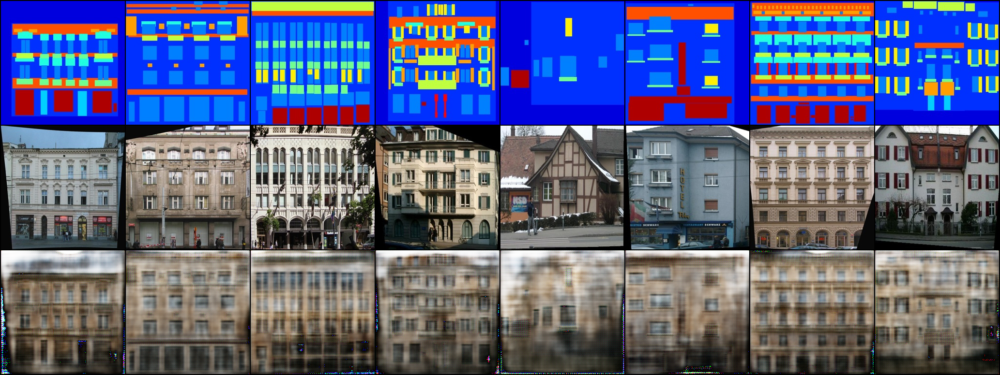

Epoch: 41/200, gen_loss: 9.8357515335083, discr_loss: 0.002784240525215864
Epoch: 42/200, gen_loss: 10.154479026794434, discr_loss: 0.001477409154176712
Epoch: 43/200, gen_loss: 8.277013778686523, discr_loss: 0.0009450478246435523
Epoch: 44/200, gen_loss: 8.351994514465332, discr_loss: 0.001682769157923758
Epoch: 45/200, gen_loss: 8.780570983886719, discr_loss: 0.0010406591463834047
Epoch: 46/200, gen_loss: 9.424996376037598, discr_loss: 0.0009352944325655699
Epoch: 47/200, gen_loss: 8.562929153442383, discr_loss: 0.0018650663550943136
Epoch: 48/200, gen_loss: 8.895033836364746, discr_loss: 0.0006622849032282829
Epoch: 49/200, gen_loss: 8.014866828918457, discr_loss: 0.269362211227417
Epoch: 50/200, gen_loss: 9.219164848327637, discr_loss: 0.008532716892659664
Epoch: 51/200, gen_loss: 8.263799667358398, discr_loss: 0.010087477043271065
Epoch: 52/200, gen_loss: 8.081348419189453, discr_loss: 0.001849146094173193
Epoch: 53/200, gen_loss: 7.592056751251221, discr_loss: 0.00115979649126529

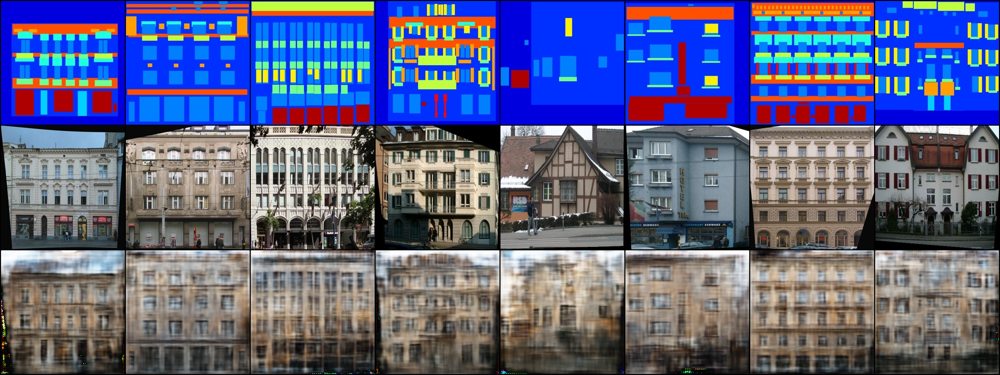

Epoch: 81/200, gen_loss: 7.268604755401611, discr_loss: 0.0011578029952943325
Epoch: 82/200, gen_loss: 7.131946563720703, discr_loss: 0.0011886958964169025
Epoch: 83/200, gen_loss: 5.9137396812438965, discr_loss: 0.001155701233074069
Epoch: 84/200, gen_loss: 7.204993724822998, discr_loss: 0.0014347204705700278
Epoch: 85/200, gen_loss: 6.017253398895264, discr_loss: 0.0024839285761117935
Epoch: 86/200, gen_loss: 7.2405924797058105, discr_loss: 0.0009169754339382052
Epoch: 87/200, gen_loss: 6.779397010803223, discr_loss: 0.0003638479975052178
Epoch: 88/200, gen_loss: 6.684528827667236, discr_loss: 0.1941853165626526
Epoch: 89/200, gen_loss: 5.919793128967285, discr_loss: 0.041090626269578934
Epoch: 90/200, gen_loss: 7.102540969848633, discr_loss: 0.020370686426758766
Epoch: 91/200, gen_loss: 6.122891426086426, discr_loss: 0.0031302454881370068
Epoch: 92/200, gen_loss: 6.759133338928223, discr_loss: 0.0025051762349903584
Epoch: 93/200, gen_loss: 6.5851850509643555, discr_loss: 0.001849874

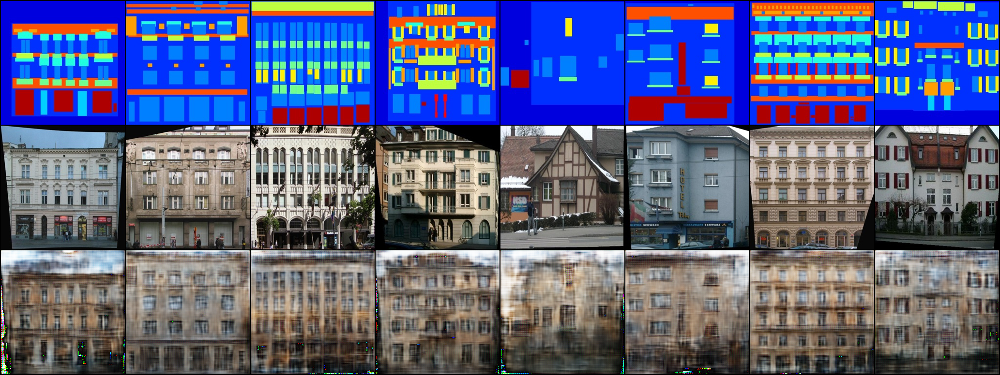

Epoch: 121/200, gen_loss: 6.485438823699951, discr_loss: 0.0023972559720277786
Epoch: 122/200, gen_loss: 6.452296257019043, discr_loss: 0.0007537976489402354
Epoch: 123/200, gen_loss: 5.9328813552856445, discr_loss: 0.0006261651869863272
Epoch: 124/200, gen_loss: 5.416527271270752, discr_loss: 0.0006982550257816911
Epoch: 125/200, gen_loss: 6.06510066986084, discr_loss: 0.0034692813642323017
Epoch: 126/200, gen_loss: 5.930578231811523, discr_loss: 0.0004092296294402331
Epoch: 127/200, gen_loss: 6.070639610290527, discr_loss: 0.0027823448181152344
Epoch: 128/200, gen_loss: 5.955430507659912, discr_loss: 0.0006130816764198244
Epoch: 129/200, gen_loss: 5.8223066329956055, discr_loss: 0.0003334397915750742
Epoch: 130/200, gen_loss: 5.733817100524902, discr_loss: 0.000365774380043149
Epoch: 131/200, gen_loss: 5.503908157348633, discr_loss: 0.0004960665246471763
Epoch: 132/200, gen_loss: 5.586125373840332, discr_loss: 0.00029251823434606194
Epoch: 133/200, gen_loss: 5.127952575683594, discr_

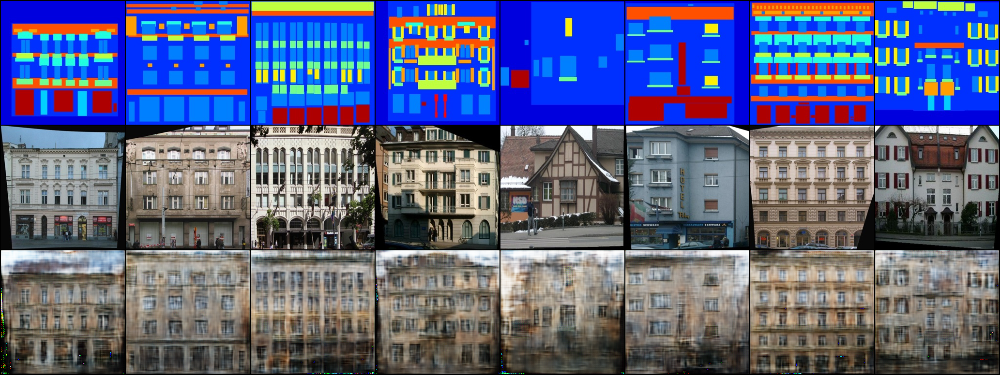

Epoch: 161/200, gen_loss: 4.9795942306518555, discr_loss: 0.00016130978474393487
Epoch: 162/200, gen_loss: 5.329166889190674, discr_loss: 0.001000043237581849
Epoch: 163/200, gen_loss: 5.335172653198242, discr_loss: 0.000672672176733613
Epoch: 164/200, gen_loss: 5.652225971221924, discr_loss: 0.001540514873340726
Epoch: 165/200, gen_loss: 5.390520095825195, discr_loss: 0.0013708670157939196
Epoch: 166/200, gen_loss: 5.049348831176758, discr_loss: 0.0026163931470364332
Epoch: 167/200, gen_loss: 5.763668537139893, discr_loss: 0.0005865246057510376
Epoch: 168/200, gen_loss: 5.508269786834717, discr_loss: 0.00029986267327331007
Epoch: 169/200, gen_loss: 5.077583312988281, discr_loss: 0.001019393210299313
Epoch: 170/200, gen_loss: 5.381126403808594, discr_loss: 0.0010457816533744335
Epoch: 171/200, gen_loss: 5.198627948760986, discr_loss: 0.0018084854818880558
Epoch: 172/200, gen_loss: 5.237783908843994, discr_loss: 0.0007384321070276201
Epoch: 173/200, gen_loss: 5.070779800415039, discr_lo

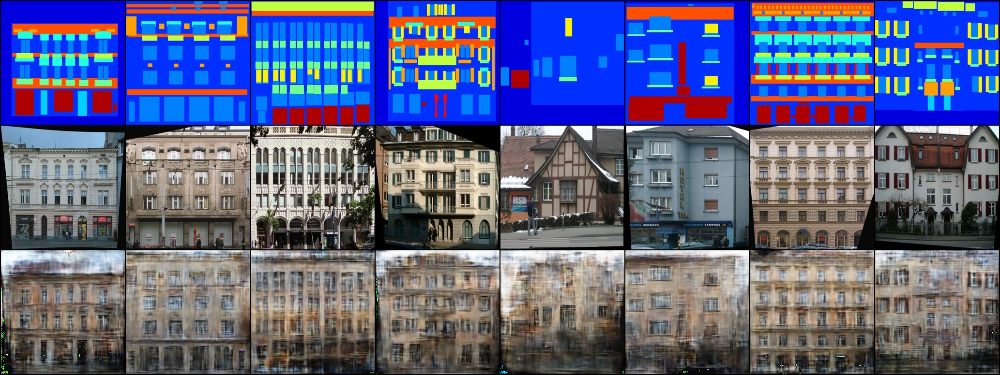

In [ ]:
gen_hist, discr_hist = [], []
test_source, test_real = next(iter(test_dataloader))

for epoch in range(1, N_STEPS + 1):

    for i, batch in enumerate(train_dataloader):
        # Get images
        source, real = batch
        source = source.to(device)
        real = real.to(device)

        # Turn right mode
        gen.eval()
        discr.train()

        # Learn discriminator
        fake = gen(source)
        discr_real = discr(torch.cat((source, real), 1))
        discr_fake = discr(torch.cat((source, fake), 1))
        ones = torch.ones_like(discr_real).to(device)
        zeros = torch.zeros_like(discr_fake).to(device)
        real_loss = F.mse_loss(discr_real, ones)
        fake_loss = F.mse_loss(discr_fake, zeros)
        discr_loss = (fake_loss + real_loss) / 2
        discr_opt.zero_grad()
        discr_loss.backward()
        discr_opt.step()
        discr_hist.append(discr_loss.item())
        
        # Turn right mode
        gen.train()
        discr.eval()
        
        # Learn generator
        fake = gen(source)
        discr_fake = discr(torch.cat((source, fake), 1))
        ones = torch.ones_like(discr_real).to(device)
        gen_mse_loss = F.mse_loss(discr_fake, ones)
        gen_loss = gen_mse_loss + LAMBDA * F.l1_loss(fake, real)
        gen_opt.zero_grad()
        gen_loss.backward()
        gen_opt.step()
        gen_hist.append(gen_loss.item())

    print(f'Epoch: {epoch}/{N_STEPS}, gen_loss: {gen_hist[-1]}, discr_loss: {discr_hist[-1]}')

    if epoch % 40 == 0:
        print(f'Epoch: {epoch}')
        print('Исходное изображение - 1ый ряд, целевое изображение - 2ой ряд, полученное изображение - 3ий ряд')
        gen.train()
        test_fake = gen(test_source.to(device)).cpu().detach()
        image = torch.cat([test_source, test_real, test_fake], dim=0)
        display(transforms.ToPILImage()(utils.make_grid(image)))

В результате 200 эпох обучения на сгенерированных картинках виден фасад и некоторые характерные элементы домов, однако картинки получились низкого качества. Улучшить качество картинок можно за счет увеличения глубины сети и количества эпох обучения.

## Часть 2. CycleGAN

Вторая часть -- реализация CycleGAN. Предлагается на том же датасете реализовать базовую конструкцию CycleGAN для unpaired style transfer, то есть переноса стилей, каждый из которых задан неразмеченным датасетом.

In [34]:
from itertools import chain
import random

In [39]:
# Сделаем неспаренный датасет выбором случайных картинок
class UnpairedDataset(torch.utils.data.Dataset):
    
    def __init__(self, folder=PATH + 'facades/train'):
        self.folder = folder
        self.files = glob(self.folder + '/*.jpg');
        self.transforms = transforms.Compose([
            transforms.ToTensor(),
        ])
        
    def __getitem__(self, idx):
        img1 = Image.open(random.choice(self.files)).convert("RGB")
        img2 = Image.open(random.choice(self.files)).convert("RGB")
        first_img, second_img = img1.crop((256, 0, 512, 256)), img2.crop((0, 0, 256, 256))
        return self.transforms(first_img), self.transforms(second_img)    
        
    def __len__(self):
        return len(self.files)


train_dataset = UnpairedDataset(folder=PATH + 'facades/train')
train_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)

# Для тестового датасета оставим спаренные картинки для удобства просмотра результатов
test_dataset = Dataset(folder=PATH + 'facades/test')
test_dataloader = torch.utils.data.DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)

In [40]:
gen1 = UnetGenerator(input_nc=3, output_nc=3, n_downs=8, n_filt=64, use_dropout=False).to(device)
discr1 = Discriminator(input_dim=3, n_filt=64, use_bias=False).to(device)

gen2 = UnetGenerator(input_nc=3, output_nc=3, n_downs=8, n_filt=64, use_dropout=False).to(device)
discr2 = Discriminator(input_dim=3, n_filt=64, use_bias=False).to(device)

In [41]:
gen_opt = torch.optim.Adam(chain(gen1.parameters(), gen2.parameters()), lr=LR, betas=(BETA, 0.999))
discr_opt = torch.optim.Adam(chain(discr1.parameters(), discr2.parameters()), lr=LR, betas=(BETA, 0.999))

Epoch: 1/100, gen_loss: 4.128329753875732, discr_loss: 0.11233183741569519
Epoch: 2/100, gen_loss: 2.3964383602142334, discr_loss: 0.15225526690483093
Epoch: 3/100, gen_loss: 2.6893856525421143, discr_loss: 0.09216481447219849
Epoch: 4/100, gen_loss: 2.1637163162231445, discr_loss: 0.11915615946054459
Epoch: 5/100, gen_loss: 2.087813138961792, discr_loss: 0.1222967877984047
Epoch: 6/100, gen_loss: 2.087679862976074, discr_loss: 0.05908229947090149
Epoch: 7/100, gen_loss: 2.8184733390808105, discr_loss: 0.18884281814098358
Epoch: 8/100, gen_loss: 2.2009658813476562, discr_loss: 0.04499989002943039
Epoch: 9/100, gen_loss: 2.0353569984436035, discr_loss: 0.04759768396615982
Epoch: 10/100, gen_loss: 2.1769027709960938, discr_loss: 0.06355785578489304
Epoch: 10
Сегментация фасада - 1ый ряд, плученные изображения - 2ой и 4ый ряд, фото фасада - 3ий ряд


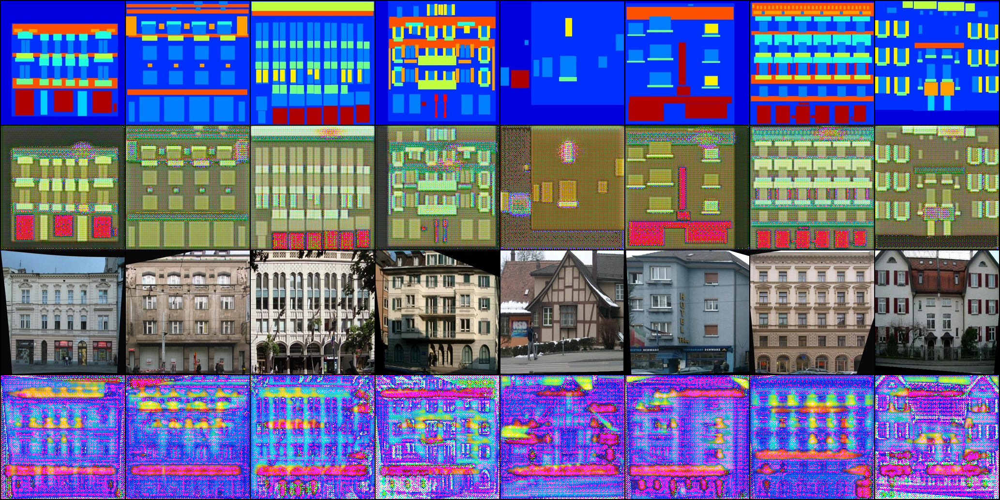

Epoch: 11/100, gen_loss: 2.43308162689209, discr_loss: 0.0616731271147728
Epoch: 12/100, gen_loss: 2.2687764167785645, discr_loss: 0.02824191190302372
Epoch: 13/100, gen_loss: 1.8965506553649902, discr_loss: 0.02898670732975006
Epoch: 14/100, gen_loss: 1.7917609214782715, discr_loss: 0.029972940683364868
Epoch: 15/100, gen_loss: 1.9999598264694214, discr_loss: 0.01962796226143837
Epoch: 16/100, gen_loss: 2.0593767166137695, discr_loss: 0.021249525249004364
Epoch: 17/100, gen_loss: 2.116456985473633, discr_loss: 0.03961825370788574
Epoch: 18/100, gen_loss: 1.883934736251831, discr_loss: 0.032529231160879135
Epoch: 19/100, gen_loss: 1.7258490324020386, discr_loss: 0.09193558245897293
Epoch: 20/100, gen_loss: 1.948752760887146, discr_loss: 0.09679863601922989
Epoch: 20
Сегментация фасада - 1ый ряд, плученные изображения - 2ой и 4ый ряд, фото фасада - 3ий ряд


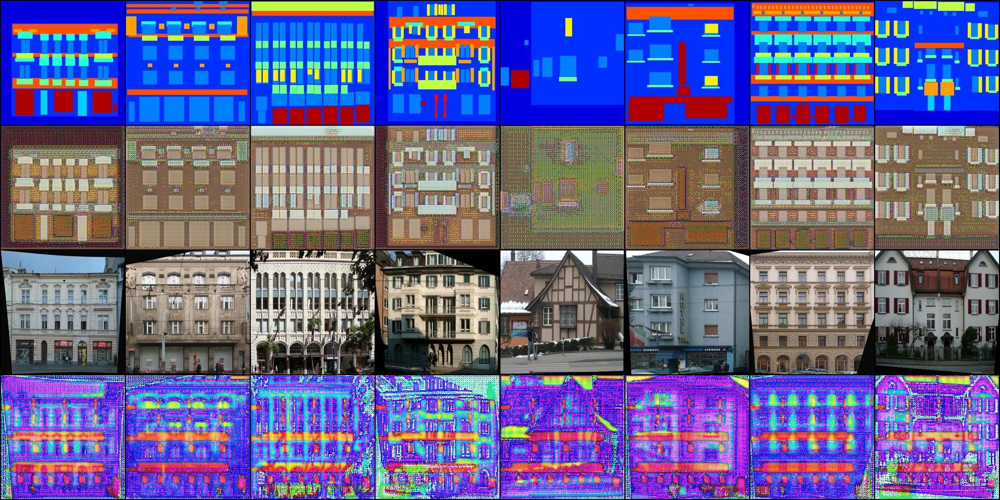

Epoch: 21/100, gen_loss: 1.8255188465118408, discr_loss: 0.01353257242590189
Epoch: 22/100, gen_loss: 1.961344599723816, discr_loss: 0.027347728610038757
Epoch: 23/100, gen_loss: 1.8683836460113525, discr_loss: 0.030971748754382133
Epoch: 24/100, gen_loss: 2.363492012023926, discr_loss: 0.07814572006464005
Epoch: 25/100, gen_loss: 1.6875829696655273, discr_loss: 0.042296987026929855
Epoch: 26/100, gen_loss: 1.869234323501587, discr_loss: 0.01644720323383808
Epoch: 27/100, gen_loss: 1.746330976486206, discr_loss: 0.012219354510307312
Epoch: 28/100, gen_loss: 1.7130995988845825, discr_loss: 0.07633186131715775
Epoch: 29/100, gen_loss: 1.7815685272216797, discr_loss: 0.015573680400848389
Epoch: 30/100, gen_loss: 1.8842747211456299, discr_loss: 0.02729170024394989
Epoch: 30
Сегментация фасада - 1ый ряд, плученные изображения - 2ой и 4ый ряд, фото фасада - 3ий ряд


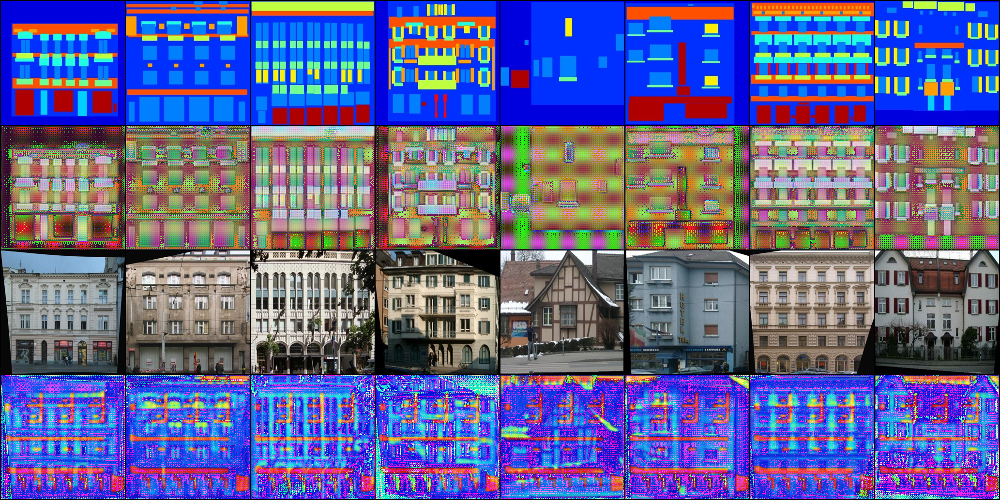

Epoch: 31/100, gen_loss: 1.8527181148529053, discr_loss: 0.01355810184031725
Epoch: 32/100, gen_loss: 2.075127601623535, discr_loss: 0.019288336858153343
Epoch: 33/100, gen_loss: 1.6756893396377563, discr_loss: 0.005007543601095676
Epoch: 34/100, gen_loss: 1.6864063739776611, discr_loss: 0.09835222363471985
Epoch: 35/100, gen_loss: 1.8344333171844482, discr_loss: 0.024898948147892952


In [ ]:
gen_hist, discr_hist = [], []
NUM_EPOCHS = (N_STEPS + 1) // 2
LAMBDA = 10

for epoch in range(1, NUM_EPOCHS):

    for i, batch in enumerate(train_dataloader):
        # Get images
        real_x, real_y = batch
        real_x = real_x.to(device)
        real_y = real_y.to(device)

        # Turn right mode
        gen1.eval()
        gen2.eval()
        discr1.train()
        discr2.train()

        # Learn discriminators
        fake_y = gen1(real_x)
        fake_x = gen2(real_y)
        
        discr1_x_fake = discr1(fake_x)
        discr1_x_real = discr1(real_x)
        discr1_fake_loss = F.mse_loss(discr1_x_fake, torch.zeros_like(discr1_x_fake).to(device))
        discr1_real_loss = F.mse_loss(discr1_x_real, torch.ones_like(discr1_x_real).to(device))
        discr2_y_fake = discr2(fake_y)
        discr2_y_real = discr2(real_y)
        discr2_fake_loss = F.mse_loss(discr2_y_fake, torch.zeros_like(discr2_y_fake).to(device))
        discr2_real_loss = F.mse_loss(discr2_y_real, torch.ones_like(discr2_y_real).to(device))
        discr_loss = (discr1_fake_loss + discr1_real_loss + discr2_fake_loss + discr2_real_loss) / 2
        
        discr_opt.zero_grad()
        discr_loss.backward()
        discr_opt.step()
        discr_hist.append(discr_loss.item())
        
        # Turn right mode
        gen1.train()
        gen2.train()
        discr1.eval()
        discr2.eval()
        
        # Learn generators
        fake_y = gen1(real_x)
        fake_x = gen2(real_y)
        recovered_x = gen2(fake_y)
        recovered_y = gen1(fake_x)
        
        identity_loss = LAMBDA * F.l1_loss(real_x, recovered_x) + LAMBDA * F.l1_loss(real_y, recovered_y)
        discr1_x_fake = discr1(fake_x)
        discr2_y_fake = discr2(fake_y)
        discr1_x_fake_loss = F.mse_loss(discr1_x_fake, torch.ones_like(discr1_x_fake).to(device))
        discr2_y_fake_loss = F.mse_loss(discr2_y_fake, torch.ones_like(discr2_y_fake).to(device))
        gen_loss = discr1_x_fake_loss + discr2_y_fake_loss + identity_loss
        
        gen_opt.zero_grad()
        gen_loss.backward()
        gen_opt.step()
        gen_hist.append(gen_loss.item())

    print(f'Epoch: {epoch}/{NUM_EPOCHS}, gen_loss: {gen_hist[-1]}, discr_loss: {discr_hist[-1]}')

    if epoch % 10 == 0:
        print(f'Epoch: {epoch}')
        print('Сегментация фасада - 1ый ряд, полученные изображения - 2ой и 4ый ряд, фото фасада - 3ий ряд')
        gen1.eval() 
        gen2.eval()
        for x, y in test_dataloader:
            fake_y = gen1(x.to(device)).cpu().detach()
            fake_x = gen2(y.to(device)).cpu().detach()
            image = torch.cat([x, fake_y, y, fake_x], dim=0)
            display(transforms.ToPILImage()(utils.make_grid(image)))
            break

Обучить модель на большем количестве эпох не удалось в связи с вычислительными трудностями и лимитами на Google Colab. Однако на сгенерированных картинках отчетливо виден перенос стиля с одного фото и использования контента другого фото (2й и 4й ряд).